## Advanced Lane Finding Project

The goals / steps of this project are the following:

1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
2. Apply a distortion correction to raw images.
3. Use color transforms, gradients, etc., to create a thresholded binary image.
4. Apply a perspective transform to rectify binary image ("birds-eye view").
5. Detect lane pixels and fit to find the lane boundary.
6. Determine the curvature of the lane and vehicle position with respect to center.
7. Warp the detected lane boundaries back onto the original image.
8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.



## Libraries

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline

## Helper functions

In [50]:
def convert_BRG_to_RGB(bgr_img):
    b,g,r = cv2.split(bgr_img)
    return cv2.merge([r,g,b])

def convert_RGB_to_BRG(rgb_img):
    r,g,b = cv2.split(rgb_img)
    return cv2.merge([b,g,r])

def display_image(original_img,undistorted_img,original_img_title,undistorted_img_title):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(original_img)
    ax1.set_title(original_img_title, fontsize=50)
    ax2.imshow(undistorted_img)
    ax2.set_title(undistorted_img_title, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

def display_image_with_gray_cmap(original_img,undistorted_img,original_img_title,undistorted_img_title):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(original_img)
    ax1.set_title(original_img_title, fontsize=50)
    ax2.imshow(undistorted_img, cmap='gray')
    ax2.set_title(undistorted_img_title, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

def display_lane_curvature_and_car_position(undist,unwarped):
    font = cv2.FONT_HERSHEY_SIMPLEX
    fontScale = 1
    fontColor = (255,255,255)
    lineType = 2
    mask = np.zeros_like(undist)
    mask[:,:,0] = unwarped
    masked_img = cv2.bitwise_or(undist, mask)
    curv_lane_text = "Curvature of the Lane -> {}".format(str(int(curve))) + "m."
    if (car_dev < 0):
        car_devation_text = "Car Deviation-> " + "{0:.2f}".format(abs(car_dev)) + "m. right of center"
    else:
        car_devation_text = "Car Deviation -> " + "{0:.2f}".format(abs(car_dev)) + "m. left of center"
    text = curv_lane_text + " " + car_devation_text
    cv2.putText(masked_img,curv_lane_text, (10,50), font, fontScale, fontColor, lineType)
    cv2.putText(masked_img,car_devation_text, (10,90), font, fontScale, fontColor, lineType)
    display_image(convert_BRG_to_RGB(undist),convert_BRG_to_RGB(masked_img),"Undisorted Image", "Mask Image")
    
def apply_Sobel_x(gray):
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    return scaled_sobel

def apply_treshhold_gradient_on_x(scaled_sobel,tresh_min,tresh_max):
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= tresh_min) & (scaled_sobel <= tresh_max)] = 1
    return sxbinary

def apply_treshhold_color_channel(hls,s_thresh_min,s_thresh_max):
    s_channel = hls[:,:,2]
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1
    return s_binary


def mask_img(undistorted_img,ignore_mask_color,):
    mask = np.zeros_like(undist)
    imshape = undist.shape
    vertices = np.array([[(200,imshape[0]),(520, 500), (763, 500), (1110,imshape[0])]], dtype=np.int32)
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    masked_img = cv2.bitwise_or(undist, mask)
    return masked_img

def warp_img(undist,masked_img):
    imshape = undist.shape
    vertices = np.array([[(200,imshape[0]),(520, 500), (763, 500), (1110,imshape[0])]], dtype=np.int32)
    warp_vertices = np.array([[(300,imshape[0]),(300, 500), (imshape[1]-300, 500), (imshape[1]-300,imshape[0])]], dtype=np.int32)
    M = cv2.getPerspectiveTransform(vertices.astype(np.float32), warp_vertices.astype(np.float32))
    Minv = cv2.getPerspectiveTransform(warp_vertices.astype(np.float32), vertices.astype(np.float32))
    warped_img = cv2.warpPerspective(masked_img, M, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    return warped_img


def convert_to_warp_treshold_img(img):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undist,cv2.COLOR_BGR2GRAY)
    hue_saturation_lightness = cv2.cvtColor(undist, cv2.COLOR_BGR2HLS) #HSL
    
    scaled_sobel = apply_Sobel_x(gray)
    sxbinary= apply_treshhold_gradient_on_x(scaled_sobel,20,100)
    s_binary = apply_treshhold_color_channel(hue_saturation_lightness,80,255)
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1
    warpe_treshold_img=warp_img(undist,combined_binary)
    return warpe_treshold_img

def unwarp_fitted_lines(undist, warped_threshold_img, left_fit, right_fit):
    imshape = undist.shape
    window_img = np.zeros_like(warped_threshold_img)
    for y in range(warped_threshold_img.shape[0]):
        x_axis_left_fit = int(left_fit[0]*y**2 + left_fit[1]*y + left_fit[2])
        y_axis_right_fit = int(right_fit[0]*y**2 + right_fit[1]*y + right_fit[2])
        if x_axis_left_fit < 0:
            x_axis_left_fit = 0
        if y_axis_right_fit < 0:
            y_axis_right_fit = 0
        if x_axis_left_fit >= warped_threshold_img.shape[1]:
            x_axis_left_fit = warped_threshold_img.shape[1] - 1
        if y_axis_right_fit >= warped_threshold_img.shape[1]:
            y_axis_right_fit = warped_threshold_img.shape[1] - 1

        for x in range(x_axis_left_fit, y_axis_right_fit):
            window_img[y][x] = 255
            
    vertices = np.array([[(200,imshape[0]),(520, 500), (763, 500), (1110,imshape[0])]], dtype=np.int32)
    warp_vertices = np.array([[(300, imshape[0]), (300, 500), (imshape[1] - 300, 500), (imshape[1] - 300, imshape[0])]],
                             dtype=np.int32)
    Minv = cv2.getPerspectiveTransform(warp_vertices.astype(np.float32), vertices.astype(np.float32))
    unwarped = cv2.warpPerspective(window_img, Minv, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    return unwarped


def sliding_window_fit(warped_threshold_img, nwindows, margin, minpix):
    histogram = np.sum(warped_threshold_img[warped_threshold_img.shape[0] // 2:, :], axis=0)

    # Find the peak of the left and right halves of the histogram
    midpoint = np.int(histogram.shape[0] / 2)
    leftx_current = np.argmax(histogram[:midpoint])
    rightx_current = np.argmax(histogram[midpoint:]) + midpoint

    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((warped_threshold_img, warped_threshold_img, warped_threshold_img)) * 255

    # Set height of windows
    window_height = np.int(warped_threshold_img.shape[0] / nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = warped_threshold_img.nonzero()
    non_zero_y = np.array(nonzero[0])
    non_zero_x = np.array(nonzero[1])

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = warped_threshold_img.shape[0] - (window + 1) * window_height
        win_y_high = warped_threshold_img.shape[0] - window * window_height
        win_x_left_low = leftx_current - margin
        win_x_left_high = leftx_current + margin
        win_x_right_low = rightx_current - margin
        win_x_right_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img, (win_x_left_low, win_y_low), (win_x_left_high, win_y_high),
                      (0, 255, 0), 2)
        cv2.rectangle(out_img, (win_x_right_low, win_y_low), (win_x_right_high, win_y_high),
                      (0, 255, 0), 2)

        # Identify the nonzero pixels in x and y within the window
        good_left_indices = ((non_zero_y >= win_y_low) & (non_zero_y < win_y_high) &
                          (non_zero_x >= win_x_left_low) & (non_zero_x < win_x_left_high)).nonzero()[0]
        good_right_indices = ((non_zero_y >= win_y_low) & (non_zero_y < win_y_high) &
                           (non_zero_x >= win_x_right_low) & (non_zero_x < win_x_right_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_indices)
        right_lane_inds.append(good_right_indices)

        # If you found > minpix pixels, recenter next window on their mean position
        leftx_new = 0
        rightx_new = 0
        if len(good_left_indices) > minpix:
            leftx_new = np.int(np.mean(non_zero_x[good_left_indices])) - leftx_current
        if len(good_right_indices) > minpix:
            rightx_new = np.int(np.mean(non_zero_x[good_right_indices])) - rightx_current

        # move window in parallel
        if (leftx_new > 0) and (rightx_new > 0):
            leftx_current += int((leftx_new + rightx_new) / 2)
            rightx_current += int((leftx_new + rightx_new) / 2)
        if (leftx_new < 0) and (rightx_new < 0):
            leftx_current += int((leftx_new + rightx_new) / 2)
            rightx_current += int((leftx_new + rightx_new) / 2)

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = non_zero_x[left_lane_inds]
    lefty = non_zero_y[left_lane_inds]
    rightx = non_zero_x[right_lane_inds]
    righty = non_zero_y[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # polynomials in world space
    left_fit_cr = np.polyfit(lefty * ym_per_pix, leftx * xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2)

    # Calculation of R_curve (radius of curvature)
    left_curve_rad = ((1 + (2 * left_fit_cr[0] * warped_threshold_img.shape[0] * ym_per_pix + left_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * left_fit_cr[0])
    right_curve_rad = ((1 + (2 * right_fit_cr[0] * warped_threshold_img.shape[0] * ym_per_pix + right_fit_cr[1]) ** 2) ** 1.5) / np.absolute(2 * right_fit_cr[0])
    r_curve = (left_curve_rad + right_curve_rad) / 2

    left_bottom = int(left_fit[0] * warped_threshold_img.shape[0] ** 2 + left_fit[1] * warped_threshold_img.shape[0] + left_fit[2])
    right_bottom = int(right_fit[0] * warped_threshold_img.shape[0] ** 2 + right_fit[1] * warped_threshold_img.shape[0] + right_fit[2])

    car_dev = (((left_bottom + right_bottom) / 2.0) - (warped_threshold_img.shape[1] / 2.0)) * xm_per_pix

    return left_fit, right_fit, r_curve, car_dev


    


# 1. Compute the camera calibration using chessboard images

In [3]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('../camera_cal/calibration*.jpg')


# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

cv2.destroyAllWindows()

### Calculate the undistortation of images

In [4]:
def calculate_undistortion(img,nx,ny,objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    #Search for corners in the grayscaled image
    ret, corners = cv2.findChessboardCorners(gray, (8,6), None)
    img = cv2.drawChessboardCorners(img, (8,6), corners, ret)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist, mtx, dist

### Test the Undistortation of on Chessboard images

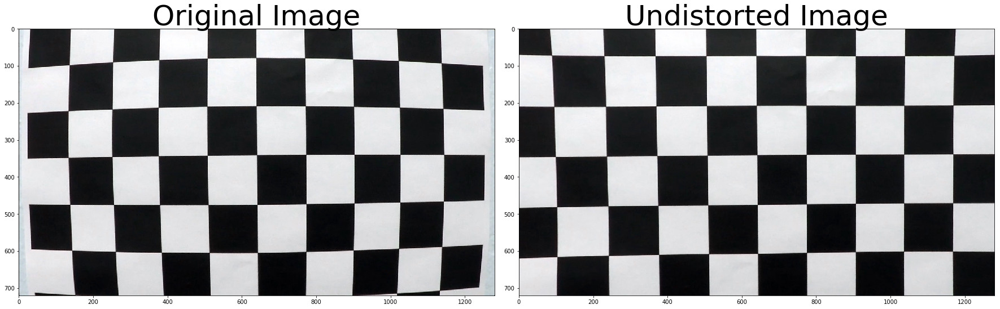

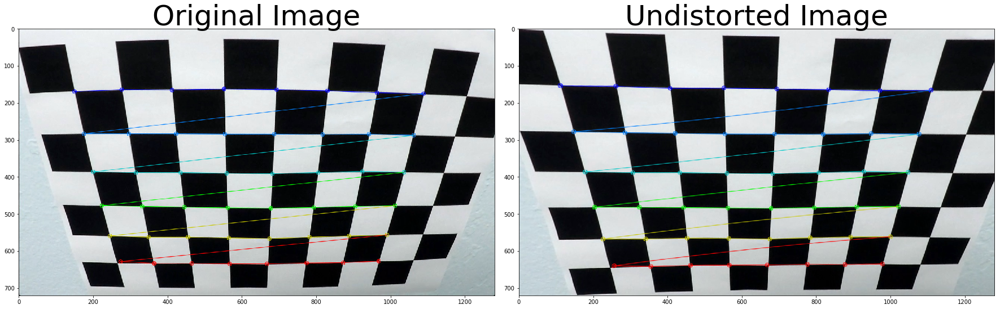

In [5]:
images = ['../camera_cal/calibration1.jpg', '../camera_cal/calibration2.jpg']
for image in images:
    original_img = cv2.imread(image)
    undistorted_img, mtx, dist = calculate_undistortion(original_img,8,6,objpoints, imgpoints)
    display_image(original_img,undistorted_img,"Original Image","Undistorted Image")

### Check Camera Calibration Matrix and Distortion Coefficients

In [6]:
print("Camera Calibration Matris is:\n{}".format(mtx))

Camera Calibration Matris is:
[[1.15396093e+03 0.00000000e+00 6.69705357e+02]
 [0.00000000e+00 1.14802496e+03 3.85656234e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


In [7]:
print("Distortion Coefficients is:\n{}".format(dist))

Distortion Coefficients is:
[[-2.41017956e-01 -5.30721173e-02 -1.15810355e-03 -1.28318856e-04
   2.67125290e-02]]


# 2. Apply a distortion correction to raw images.

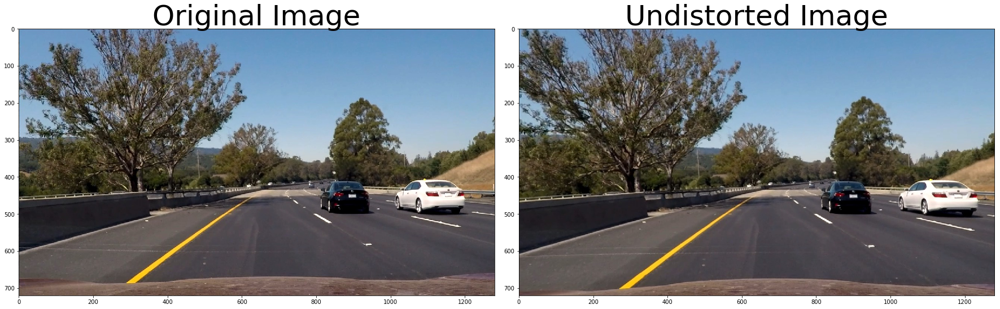

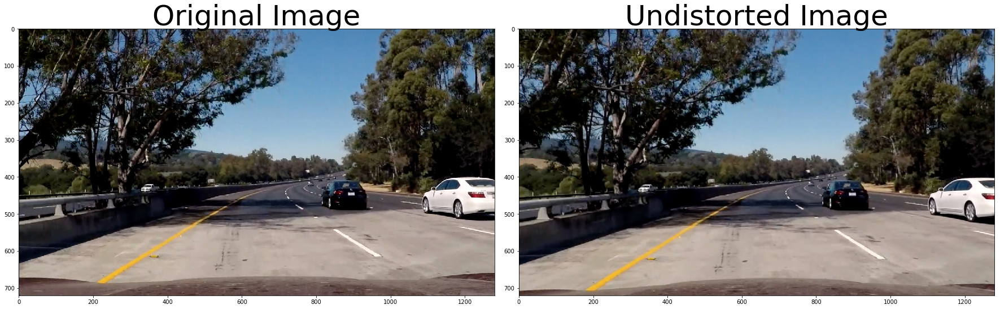

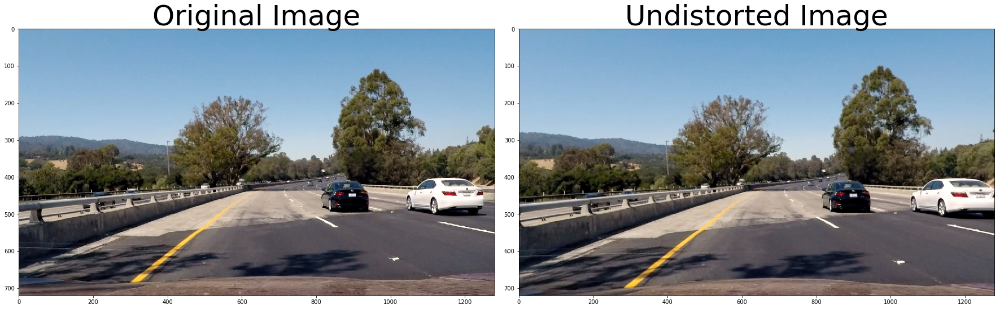

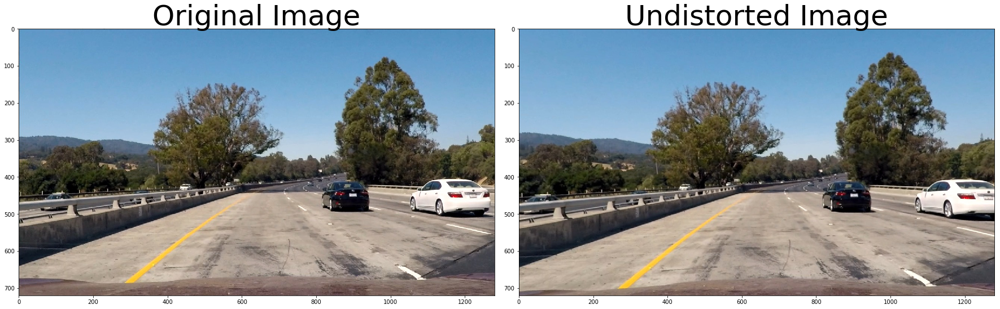

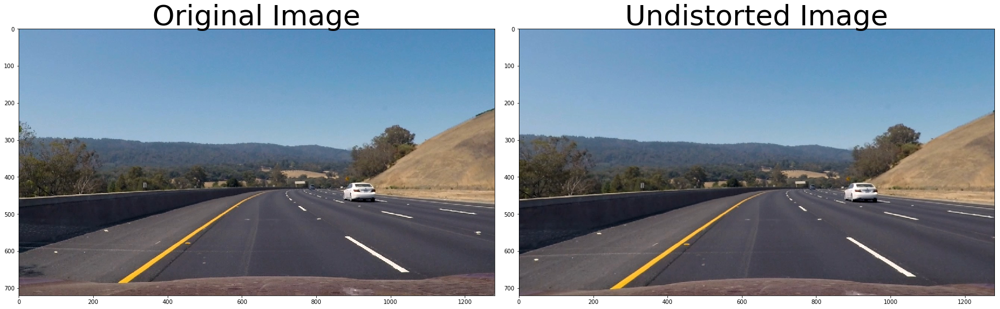

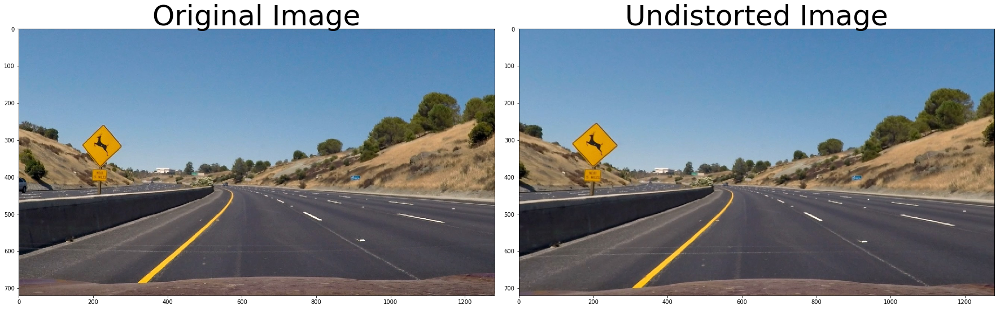

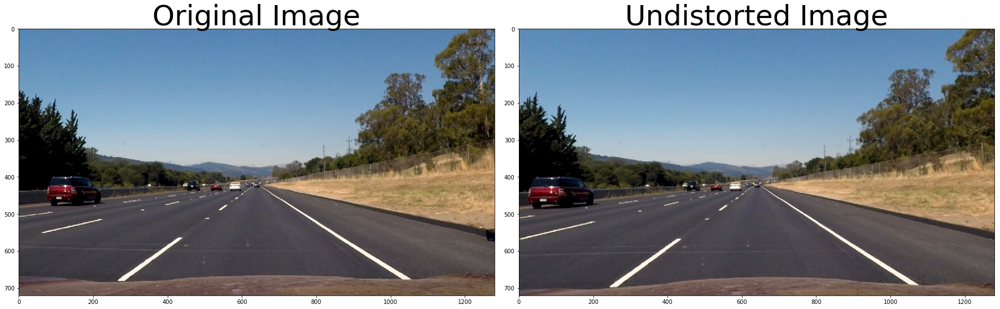

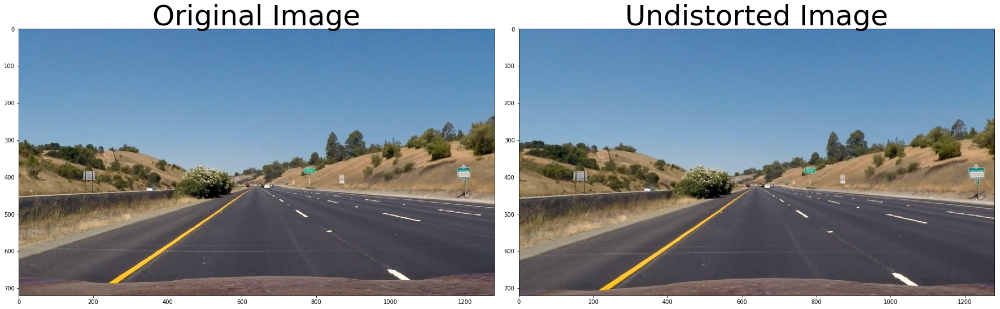

In [8]:
test_images = glob.glob('../test_images/*.jpg')
for image in test_images:
    original_img = cv2.imread(image)
    undistorted_img = cv2.undistort(original_img, mtx, dist, None, mtx)
    display_image(convert_BRG_to_RGB(original_img),convert_RGB_to_BRG(undistorted_img),'Original Image','Undistorted Image')

# 3. Use color transforms, gradients to create a thresholded binary image

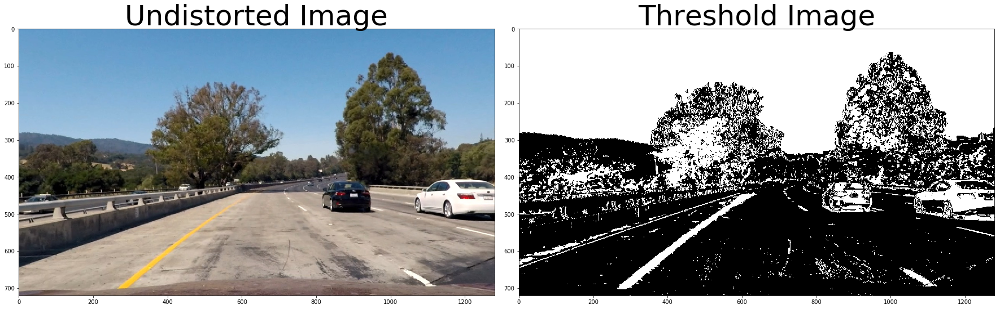

In [9]:
test_img = cv2.imread('../test_images/test1.jpg')
undist = cv2.undistort(test_img, mtx, dist, None, mtx)
gray = cv2.cvtColor(undist,cv2.COLOR_BGR2GRAY)
hue_saturation_lightness = cv2.cvtColor(undist, cv2.COLOR_BGR2HLS) #HSL

scaled_sobel = apply_Sobel_x(gray)
sxbinary= apply_treshhold_gradient_on_x(scaled_sobel,20,100)
s_binary = apply_treshhold_color_channel(hue_saturation_lightness,80,255)

color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
combined_binary = np.zeros_like(sxbinary)
combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1

display_image_with_gray_cmap(convert_BRG_to_RGB(undist),combined_binary,'Undistorted Image','Threshold Image')







# 4. Apply a perspective transform to rectify binary image ("birds-eye view")

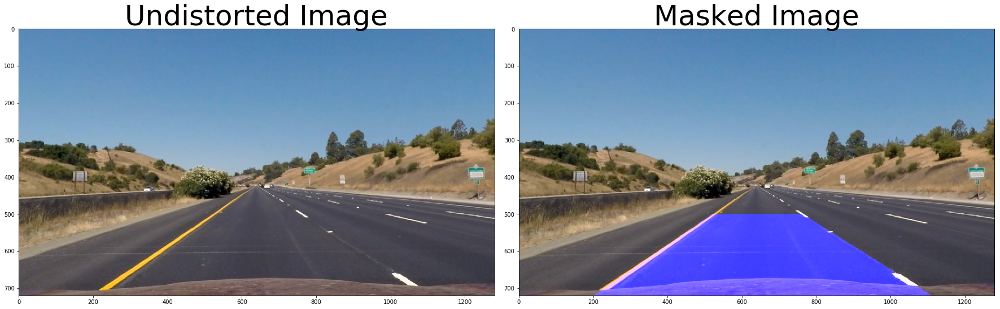

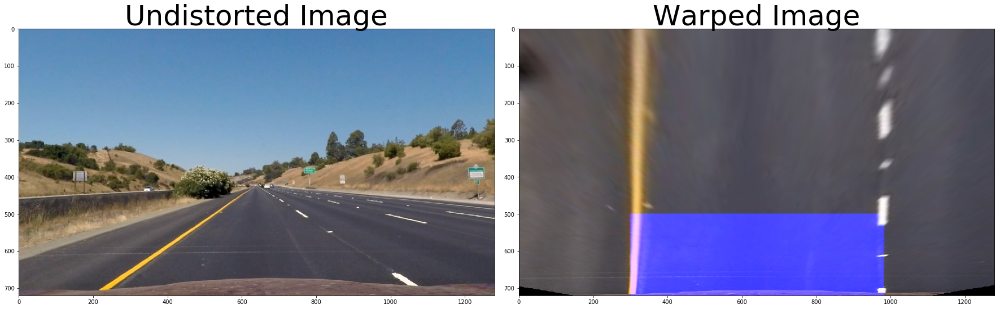

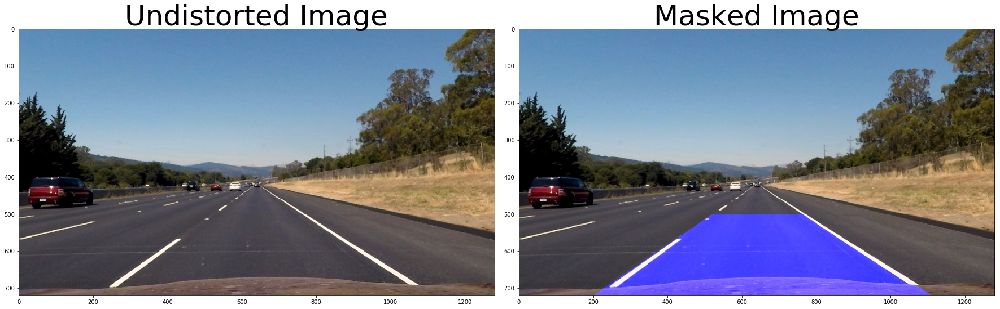

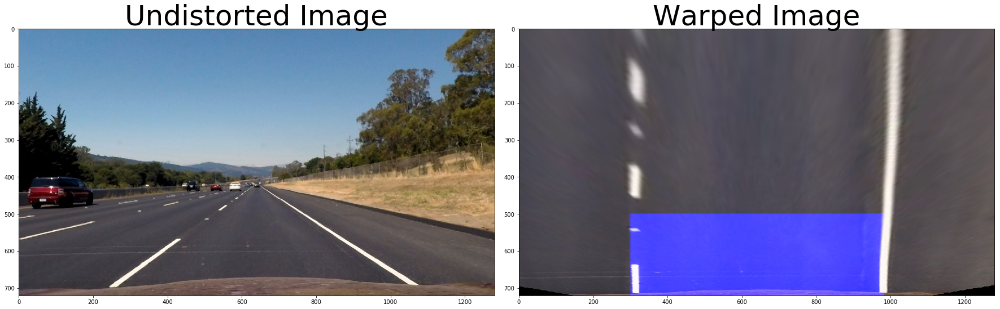

In [10]:
test_images = ['../test_images/straight_lines1.jpg', '../test_images/straight_lines2.jpg']
for image in test_images:
    straight_line_img = cv2.imread(image)
    undist = cv2.undistort(straight_line_img, mtx, dist, None, mtx)
    masked_img = mask_img(undist,255)
    warped_img = warp_img(undist,masked_img)
    display_image(convert_BRG_to_RGB(undist),convert_BRG_to_RGB(masked_img),"Undistorted Image","Masked Image")
    display_image(convert_BRG_to_RGB(undist),convert_BRG_to_RGB(warped_img),"Undistorted Image","Warped Image")





# 5. Detect lane pixels and fit to find the lane boundary.

### Convert Original Image to Warp Treshhold Image

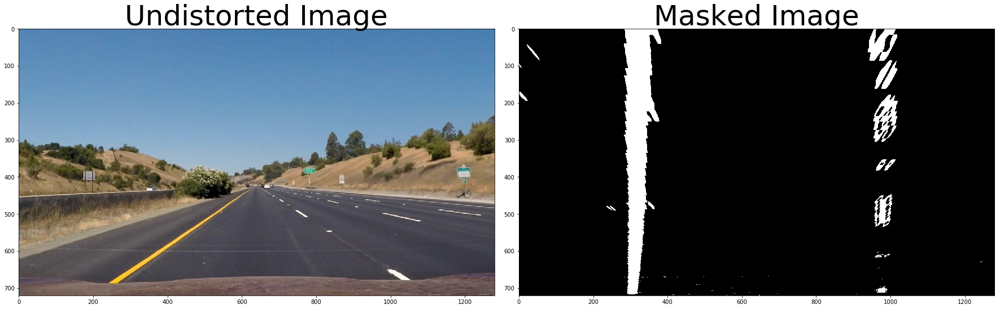

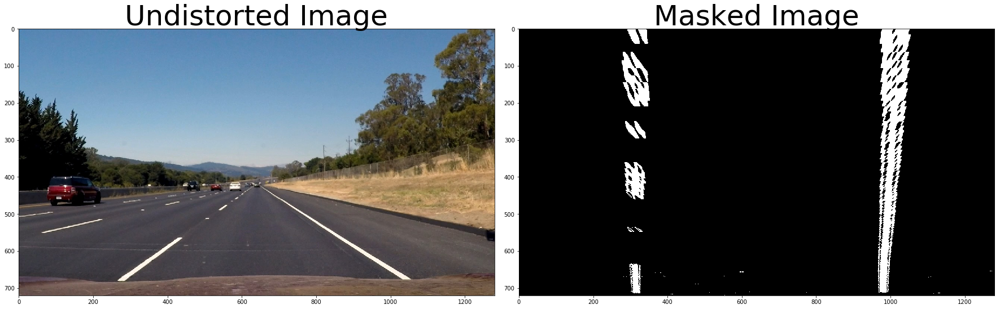

In [11]:
test_images = ['../test_images/straight_lines1.jpg', '../test_images/straight_lines2.jpg']
for image in test_images:
    straight_line_img = cv2.imread(image)
    warped_threshold_img=convert_to_warp_treshold_img(straight_line_img)
    display_image_with_gray_cmap(convert_BRG_to_RGB(straight_line_img),warped_threshold_img,"Undistorted Image","Masked Image")

    

### Find Line Histogram

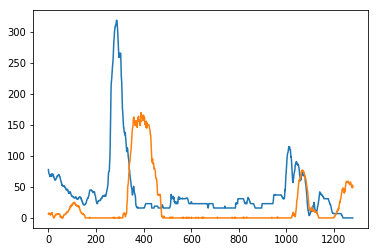

In [12]:
test_images = ['../test_images/test5.jpg', '../test_images/test6.jpg']
for image in test_images:
    straight_line_img = cv2.imread(image)
    warped_threshold_img=convert_to_warp_treshold_img(straight_line_img)
    histogram = np.sum(warped_threshold_img[warped_threshold_img.shape[0]//2:,:], axis=0)
    plt.plot(histogram)

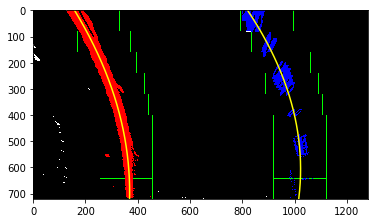

In [13]:
def plot_sliding_window_fit_left_and_right_lane(warped_threshold_img, nwindows, margin, minpix):
    histogram = np.sum(warped_threshold_img[warped_threshold_img.shape[0] // 2:, :], axis=0)

    # Find the peak of the left and right halves of the histogram
    midpoint = np.int(histogram.shape[0] / 2)
    leftx_current = np.argmax(histogram[:midpoint])
    rightx_current = np.argmax(histogram[midpoint:]) + midpoint

    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((warped_threshold_img, warped_threshold_img, warped_threshold_img)) * 255

    # Set height of windows
    window_height = np.int(warped_threshold_img.shape[0] / nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = warped_threshold_img.nonzero()
    non_zero_y = np.array(nonzero[0])
    non_zero_x = np.array(nonzero[1])

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = warped_threshold_img.shape[0] - (window + 1) * window_height
        win_y_high = warped_threshold_img.shape[0] - window * window_height
        win_x_left_low = leftx_current - margin
        win_x_left_high = leftx_current + margin
        win_x_right_low = rightx_current - margin
        win_x_right_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img, (win_x_left_low, win_y_low), (win_x_left_high, win_y_high),
                      (0, 255, 0), 2)
        cv2.rectangle(out_img, (win_x_right_low, win_y_low), (win_x_right_high, win_y_high),
                      (0, 255, 0), 2)

        # Identify the nonzero pixels in x and y within the window
        good_left_indices = ((non_zero_y >= win_y_low) & (non_zero_y < win_y_high) &
                          (non_zero_x >= win_x_left_low) & (non_zero_x < win_x_left_high)).nonzero()[0]
        good_right_indices = ((non_zero_y >= win_y_low) & (non_zero_y < win_y_high) &
                           (non_zero_x >= win_x_right_low) & (non_zero_x < win_x_right_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_indices)
        right_lane_inds.append(good_right_indices)

        # If you found > minpix pixels, recenter next window on their mean position
        leftx_new = 0
        rightx_new = 0
        if len(good_left_indices) > minpix:
            leftx_new = np.int(np.mean(non_zero_x[good_left_indices])) - leftx_current
        if len(good_right_indices) > minpix:
            rightx_new = np.int(np.mean(non_zero_x[good_right_indices])) - rightx_current

        # move window in parallel
        if (leftx_new > 0) and (rightx_new > 0):
            leftx_current += int((leftx_new + rightx_new) / 2)
            rightx_current += int((leftx_new + rightx_new) / 2)
        if (leftx_new < 0) and (rightx_new < 0):
            leftx_current += int((leftx_new + rightx_new) / 2)
            rightx_current += int((leftx_new + rightx_new) / 2)

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = non_zero_x[left_lane_inds]
    lefty = non_zero_y[left_lane_inds]
    rightx = non_zero_x[right_lane_inds]
    righty = non_zero_y[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, warped_threshold_img.shape[0] - 1, warped_threshold_img.shape[0])
    left_fitx = left_fit[0] * ploty ** 2 + left_fit[1] * ploty + left_fit[2]
    right_fitx = right_fit[0] * ploty ** 2 + right_fit[1] * ploty + right_fit[2]
    out_img[non_zero_y[left_lane_inds], non_zero_x[left_lane_inds]] = [255, 0, 0]
    out_img[non_zero_y[right_lane_inds], non_zero_x[right_lane_inds]] = [0, 0, 255]
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)


nwindows = 9
margin = 100
minpix = 50

test_img = cv2.imread('../test_images/test2.jpg')
warped_threshold_img = convert_to_warp_treshold_img(test_img)
plot_sliding_window_fit_left_and_right_lane(warped_threshold_img, nwindows, margin, minpix)


# 6. Determine the curvature of the lane and vehicle position with respect to center

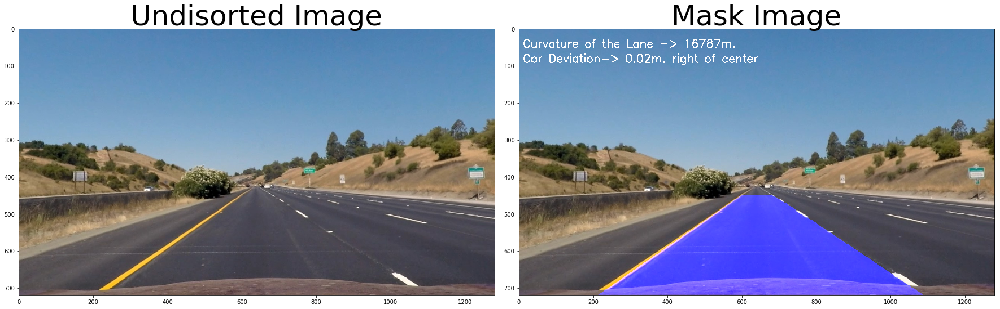

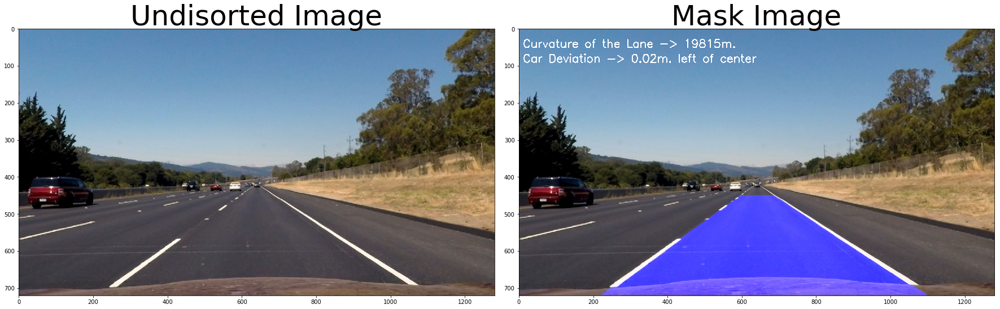

In [51]:
nwindows = 9
margin = 100
minpix = 50

    
test_images = ['../test_images/straight_lines1.jpg', '../test_images/straight_lines2.jpg']
for image in test_images:
    test_img = cv2.imread(image)
    undist = cv2.undistort(test_img, mtx, dist, None, mtx)
    warped_threshold_img = convert_to_warp_treshold_img(test_img)
    left_fit, right_fit, curve, car_dev = sliding_window_fit(warped_threshold_img, nwindows, margin, minpix)
    unwarped = unwarp_fitted_lines(undist,warped_threshold_img, left_fit, right_fit)
    display_lane_curvature_and_car_position(undist,unwarped)




# 7. Warp the detected lane boundaries back onto the original image

In [70]:
prev_left_fit = None
prev_right_fit = None
prev_curve = None
prev_car_dev = None
miss_frame = 0

print("Camera Calibration Matris is:\n{}".format(mtx))
print("\n")
print("Distortion Coefficients is:\n{}".format(dist))


def previous_line_fit(img, left_fit, right_fit):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30 / 720  # meters per pixel in y dimension
    xm_per_pix = 3.7 / 700  # meters per pixel in x dimension

    margin = 25

    non_zero = img.nonzero()
    non_zero_y = np.array(non_zero[0])
    non_zero_x = np.array(non_zero[1])

    left_lane_inds = ((non_zero_x > (left_fit[0] * (non_zero_y ** 2) + left_fit[1] * non_zero_y + left_fit[2] - margin))
                      & (
                          non_zero_x < (
                              left_fit[0] * (non_zero_y ** 2) + left_fit[1] * non_zero_y + left_fit[2] + margin)))

    right_lane_inds = (
        (non_zero_x > (right_fit[0] * (non_zero_y ** 2) + right_fit[1] * non_zero_y + right_fit[2] - margin))
        & (
            non_zero_x < (right_fit[0] * (non_zero_y ** 2) + right_fit[1] * non_zero_y + right_fit[2] + margin)))

    # Extract left and right line pixel positions
    left_x = non_zero_x[left_lane_inds]
    left_y = non_zero_y[left_lane_inds]
    right_x = non_zero_x[right_lane_inds]
    right_y = non_zero_y[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(left_y, left_x, 2)
    right_fit = np.polyfit(right_y, right_x, 2)

    # polynomials in world space
    left_fit_cr = np.polyfit(left_y * ym_per_pix, left_x * xm_per_pix, 2)
    right_fit_cr = np.polyfit(right_y * ym_per_pix, right_x * xm_per_pix, 2)

    # Calculation of R_curve (radius of curvature)
    left_curve_rad = ((1 + (
        2 * left_fit_cr[0] * img.shape[0] * ym_per_pix + left_fit_cr[1]) ** 2) ** 1.5) / np.absolute(
        2 * left_fit_cr[0])
    right_curve_rad = ((1 + (
        2 * right_fit_cr[0] * img.shape[0] * ym_per_pix + right_fit_cr[1]) ** 2) ** 1.5) / np.absolute(
        2 * right_fit_cr[0])

    curve = (left_curve_rad + right_curve_rad) / 2

    left_bottom = int(left_fit[0] * img.shape[0] ** 2 + left_fit[1] * img.shape[0] + left_fit[2])
    right_bottom = int(
        right_fit[0] * img.shape[0] ** 2 + right_fit[1] * img.shape[0] + right_fit[2])

    car_dev = (((left_bottom + right_bottom) / 2.0) - (img.shape[1] / 2.0)) * xm_per_pix

    return left_fit, right_fit, curve, car_dev


def img_to_wrap(img, mtx, dist):
    # Threshold x gradient
    thresh_min = 20
    thresh_max = 100

    # Threshold color channel
    s_thresh_min = 80
    s_thresh_max = 255

    undist = cv2.undistort(img, mtx, dist, None, mtx)

    imshape = undist.shape
    vertices = np.array([[(200, imshape[0]), (520, 500), (763, 500), (1110, imshape[0])]], dtype=np.int32)
    warp_vertices = np.array([[(300, imshape[0]), (300, 500), (imshape[1] - 300, 500), (imshape[1] - 300, imshape[0])]],
                             dtype=np.int32)
    M = cv2.getPerspectiveTransform(vertices.astype(np.float32), warp_vertices.astype(np.float32))
    warped = cv2.warpPerspective(undist, M, (imshape[1], imshape[0]), flags=cv2.INTER_LINEAR)
    gray = cv2.cvtColor(warped, cv2.COLOR_BGR2GRAY)
    hls = cv2.cvtColor(warped, cv2.COLOR_BGR2HLS)
    s_channel = hls[:, :, 2]

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)  # Take the derivative in x
    abs_sobelx = np.absolute(sobelx)  # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255 * abs_sobelx / np.max(abs_sobelx))

    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1

    # combined_binary = s_binary
    return combined_binary, undist


def unwarp_fitted_lines(pipelined_img, left_fit, right_fit):
    window_img = np.zeros_like(pipelined_img)
    for y in range(pipelined_img.shape[0]):
        left_fit_x = int(left_fit[0] * y ** 2 + left_fit[1] * y + left_fit[2])
        right_fit_x = int(right_fit[0] * y ** 2 + right_fit[1] * y + right_fit[2])
        if left_fit_x < 0:
            left_fit_x = 0
        if right_fit_x < 0:
            right_fit_x = 0
        if left_fit_x >= pipelined_img.shape[1]:
            left_fit_x = pipelined_img.shape[1] - 1
        if right_fit_x >= pipelined_img.shape[1]:
            right_fit_x = pipelined_img.shape[1] - 1

        for x in range(left_fit_x, right_fit_x):
            window_img[y][x] = 255

    img_shape = window_img.shape
    vertices = np.array([[(200, img_shape[0]), (520, 500), (763, 500), (1110, img_shape[0])]], dtype=np.int32)
    warp_vertices = np.array(
        [[(300, img_shape[0]), (300, 500), (img_shape[1] - 300, 500), (img_shape[1] - 300, img_shape[0])]],
        dtype=np.int32)
    Minv = cv2.getPerspectiveTransform(warp_vertices.astype(np.float32), vertices.astype(np.float32))
    unwarped = cv2.warpPerspective(window_img, Minv, (img_shape[1], img_shape[0]), flags=cv2.INTER_LINEAR)
    return unwarped


def do_advance_lane_finding(img):
    global prev_left_fit
    global prev_right_fit
    global prev_curve
    global prev_car_dev
    global miss_frame

    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 1
    font_color = (255, 255, 255)
    line_type = 2

    nwindows = 9
    margin = 100
    minpix = 50

    new_img, undist = img_to_wrap(img, mtx, dist)
    if prev_car_dev is None:
        left_fit, right_fit, curve, car_dev = sliding_window_fit(warped_threshold_img, nwindows, margin, minpix)
        prev_left_fit = left_fit
        prev_right_fit = right_fit
        prev_curve = curve
        prev_car_dev = car_dev
        miss_frame = 0
    else:
        left_fit, right_fit, curve, car_dev = previous_line_fit(new_img, prev_left_fit, prev_right_fit)

    # try sliding window fit if previous_line_fit don't look good
    if abs(car_dev - prev_car_dev) > 0.1:
        left_fit, right_fit, curve, car_dev = sliding_window_fit(warped_threshold_img, nwindows, margin, minpix)

    # decide whether we use the new calculation or keep the old
    if (abs(car_dev - prev_car_dev) > 0.2) and (miss_frame < 10):
        left_fit = prev_left_fit
        right_fit = prev_right_fit
        curve = prev_curve
        car_dev = prev_car_dev
        miss_frame += 1
    else:
        prev_left_fit = left_fit
        prev_right_fit = right_fit
        prev_curve = curve
        prev_car_dev = car_dev

    unwarped = unwarp_fitted_lines(new_img, left_fit, right_fit)
    mask = np.zeros_like(undist)
    mask[:, :, 2] = unwarped
    masked_img = cv2.bitwise_or(undist, mask)
    curv_lane_text = "Curvature of the Lane -> {}".format(str(int(curve))) + " m."
    if car_dev < 0:
        car_devation_text = "Car Deviation -> " + "{0:.2f}".format(abs(car_dev)) + " m. right of center."
    else:
        car_devation_text = "Car Deviation -> " + "{0:.2f}".format(abs(car_dev)) + " m. left of center."
    cv2.putText(masked_img, curv_lane_text, (10, 50), font, font_scale, font_color, line_type)
    cv2.putText(masked_img, car_devation_text, (10, 90), font, font_scale, font_color, line_type)
    return masked_img


    

Camera Calibration Matris is:
[[1.15396093e+03 0.00000000e+00 6.69705357e+02]
 [0.00000000e+00 1.14802496e+03 3.85656234e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


Distortion Coefficients is:
[[-2.41017956e-01 -5.30721173e-02 -1.15810355e-03 -1.28318856e-04
   2.67125290e-02]]


# 8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [71]:
clip1 = VideoFileClip("../project_video.mp4")
video_output = 'project_video_out3.mp4'
out_clip = clip1.fl_image(do_advance_Lane_Finding)
%time out_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video project_video_out3.mp4
[MoviePy] Writing video project_video_out3.mp4


100%|█████████▉| 1260/1261 [05:03<00:00,  4.34it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out3.mp4 

CPU times: user 5min 43s, sys: 27 s, total: 6min 10s
Wall time: 5min 3s


In [ ]:
HTML("""<video width="1280" height="720" controls><source src="{0}"></video>""".format(video_output))